# 01wk-1: 이미지 자료 분석 (겉핥기)

최규빈  
2024-03-04

<a href="https://colab.research.google.com/github/guebin/DL2024/blob/main/posts/01wk-1.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" style="text-align: left"></a>

# 1. 강의영상

# 2. Imports

In [1]:
from fastai.vision.all import *

# 3. 데이터

`-` 다운로드 + 압축풀기

In [2]:
untar_data('https://s3.amazonaws.com/fast-ai-imageclas/oxford-iiit-pet.tgz')

Path('/root/.fastai/data/oxford-iiit-pet')

`-` 파일탐색

In [ ]:
#!ls /root/.fastai/data/oxford-iiit-pet/images #파일 저장 경로 따라서 이미지 파일들 이름 보기

`-` Abyssinian_1.jpg 을 보고싶음

PILImage.create는 주어진 파일 경로에서 이미지를 로드하여 이미지 객체를 생성하는 것.

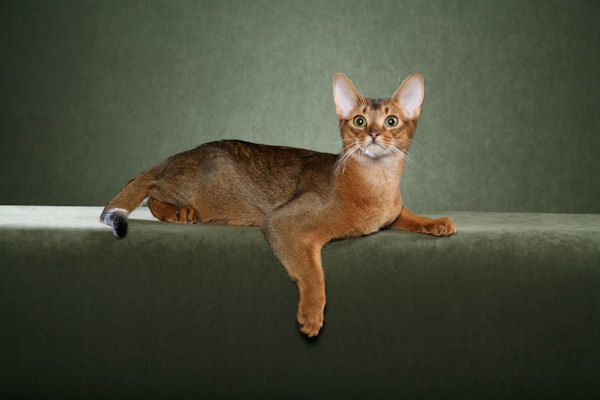

In [ ]:
PILImage.create('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg')

`-` `Abyssinian_100.jpg`를 보고싶다면?

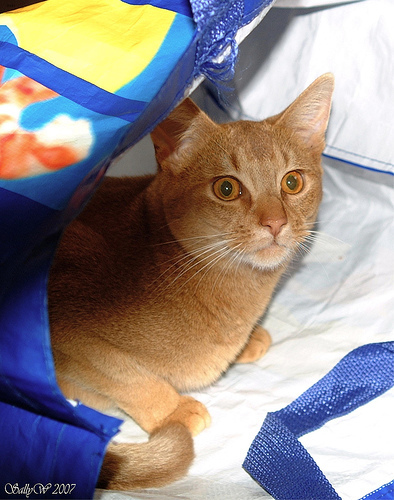

In [ ]:
PILImage.create('/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg')

`-` 그림을 확인 할 수 있는건 좋은데 이렇게 확인하니까 조금 귀찮음..

In [ ]:
lst = ['/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg',
       '/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_100.jpg']

In [ ]:
lst[0]

'/root/.fastai/data/oxford-iiit-pet/images/Abyssinian_1.jpg'

이미지 객체의 저장경로를 리스트에 저장하고 인덱싱하여 불러오는 것이군..

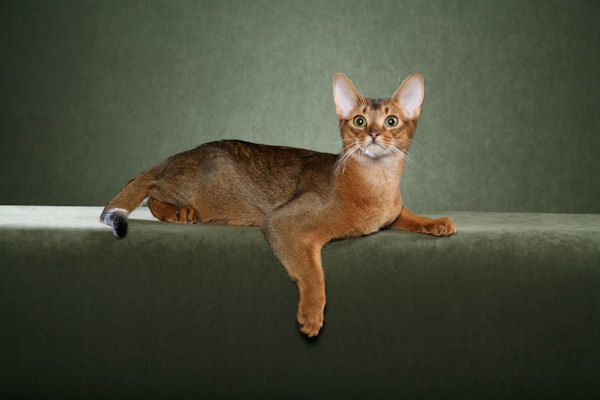

In [ ]:
PILImage.create(lst[0]) #PILImage는 ... 이미지 경로를 입력하면 이미지를 띄워줌..

get_image_files( ) 라는 메써드는 주어진 디렉토리에서 이미지 파일의 경로를 가져오는 역할. 개별의 이미지들의 경로가 리스트로 저장이 된다.

In [3]:
image_paths = get_image_files('/root/.fastai/data/oxford-iiit-pet/images')
image_paths[0]

Path('/root/.fastai/data/oxford-iiit-pet/images/beagle_150.jpg')

`-` 그림살펴보기 + 파일명으로 개/고양이 맞춰보기

/root/.fastai/data/oxford-iiit-pet/images/boxer_157.jpg


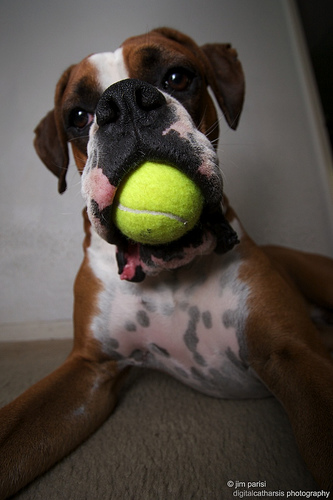

In [ ]:
print(image_paths[0])
display(PILImage.create(image_paths[0])) #이미지 객체를 시각화

In [ ]:
len(image_paths) #이미지 path가 총 7390개

7390

/root/.fastai/data/oxford-iiit-pet/images/english_setter_117.jpg


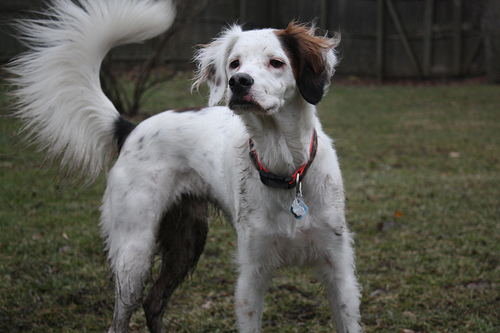

In [ ]:
print(image_paths[2])
display(PILImage.create(image_paths[2]))

/root/.fastai/data/oxford-iiit-pet/images/Bengal_145.jpg


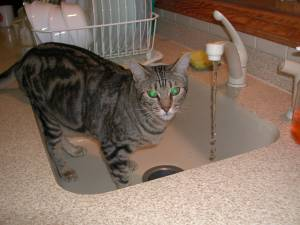

In [ ]:
print(image_paths[3])
display(PILImage.create(image_paths[3]))

/root/.fastai/data/oxford-iiit-pet/images/havanese_151.jpg


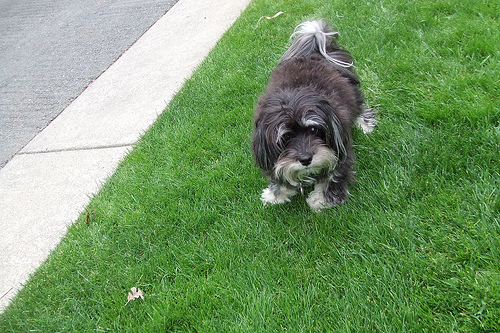

In [ ]:
print(image_paths[4])
display(PILImage.create(image_paths[4]))

/root/.fastai/data/oxford-iiit-pet/images/saint_bernard_127.jpg


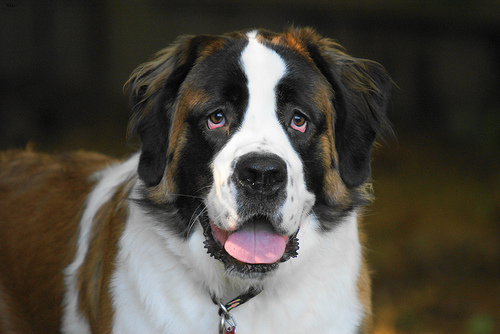

In [ ]:
print(image_paths[5])
display(PILImage.create(image_paths[5]))

/root/.fastai/data/oxford-iiit-pet/images/Bombay_96.jpg


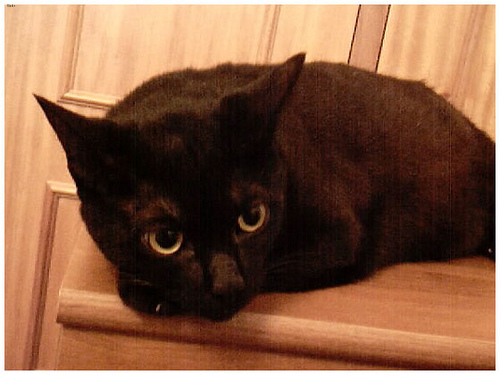

In [ ]:
print(image_paths[6])
display(PILImage.create(image_paths[6]))

/root/.fastai/data/oxford-iiit-pet/images/British_Shorthair_127.jpg


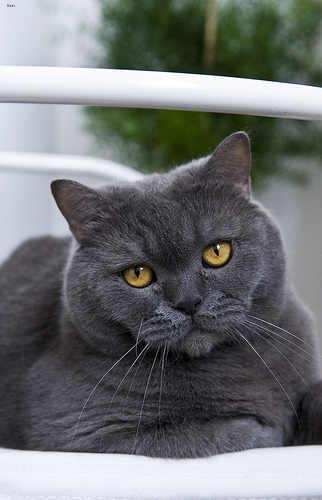

In [ ]:
print(image_paths[7])
display(PILImage.create(image_paths[7]))

/root/.fastai/data/oxford-iiit-pet/images/Persian_72.jpg


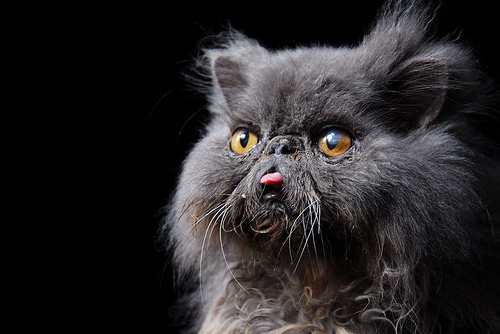

In [ ]:
print(image_paths[8])
display(PILImage.create(image_paths[8]))

#### 파일명만 보고 cat 인지 dog인지 맞추는 방법...

In [ ]:
# 특1: 대문자이면 고양이, 소문자이면 강아지그림이다!! (천재적인 저장방식)
# 특2: 이미지크기가 서로 다르다..

In [ ]:
image_paths[0]

Path('/root/.fastai/data/oxford-iiit-pet/images/boxer_157.jpg')

In [8]:
def label_func(fname):
    if fname[0].isupper(): #생각해보니... images/ 뒤의 글자를 근거로 클래스를 판단
        return 'cat'
    else:
        return 'dog'

In [ ]:
image_paths

(#7390) [Path('/root/.fastai/data/oxford-iiit-pet/images/havanese_48.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/wheaten_terrier_162.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/scottish_terrier_158.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bengal_145.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/havanese_151.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/saint_bernard_127.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Bombay_96.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/British_Shorthair_127.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/Persian_72.jpg'),Path('/root/.fastai/data/oxford-iiit-pet/images/keeshond_119.jpg')...]

In [ ]:
dls = ImageDataLoaders.from_name_func( #이미지 파일을 이름 기반으로 할당.
    path ='/root/.fastai/data/oxford-iiit-pet/images', #이미지 저장 경로 여기 경로로 들어가서 레이블의 이름을 근거로 파일을 판단..
    fnames = image_paths, #이미지들의 파일 경로가 담긴 리스트 지정
    label_func = label_func, #이미지에 대한 클래스 레이블을 동적으로 할당하는 함수 지정
    item_tfms = Resize(224) #이미지들의 크기를 획일화
)

`미니배치:` 전체 데이터셋을 나누어서 모델에 순차적으로 공급하는 작은 데이터 그룹을 일컫는 말

In [ ]:
dls.show_batch(max_n=25) #데이터 로더에서 로드한 미니배치의 이미지와 해당 이미지의 레이블 시각화

Output hidden; open in https://colab.research.google.com to view.

# 4. 학습

In [ ]:
lrnr = vision_learner(
    dls = dls, #데이터 로더 객체
    arch = resnet34, #학습 아키텍쳐, resnet34는 사전에 학습된 신경망 이제 다시 보니깐 좀 다르군,, transfer learning임
    metrics = accuracy #모델 평카 측도 (정확도)
)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 150MB/s]


In [ ]:
lrnr.fine_tune(1) # 학습을 하는 함수

epoch,train_loss,valid_loss,accuracy,time
0,0.132709,0.028430,0.991204,00:56


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


epoch,train_loss,valid_loss,accuracy,time
0,0.050686,0.013388,0.996617,01:07


# 5. 기존자료를 잘 맞추는지 확인

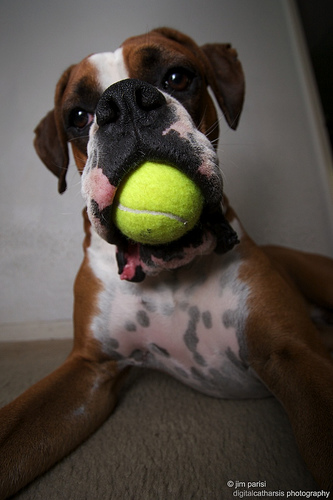

In [ ]:
PILImage.create(image_paths[0]) #이미지 객체군..

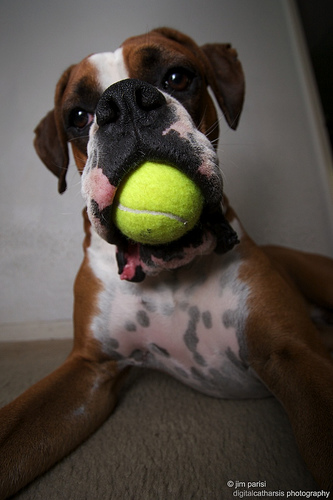

In [ ]:
img0 = PILImage.create(image_paths[0]) # 강아지
img0

In [ ]:
lrnr.predict(image_paths[0]) #경로를 넣어도 예측해주고, PILImage로 이미지화 시킨것도 예측해준다..

('dog', tensor(1), tensor([6.7324e-06, 9.9999e-01]))

In [ ]:
lrnr.predict(img0) #learner 객채를 사용하여 주어진 이미지에 대한 예측
#lrnr.predict(PILImage.create(image_paths[0]))
#lrnr.predict(image_paths[0])

('dog', tensor(1), tensor([6.7324e-06, 9.9999e-01]))

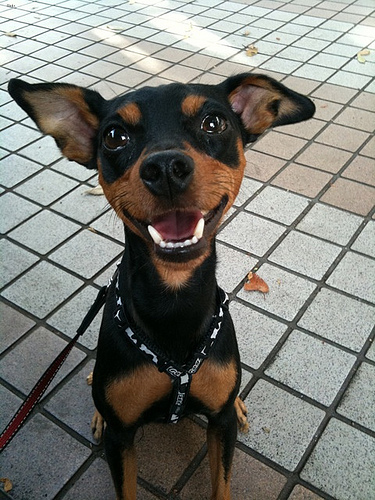

In [ ]:
img4 = PILImage.create(image_paths[4])
img4

In [ ]:
lrnr.predict(img4)

('dog', tensor(1), tensor([6.3416e-08, 1.0000e+00]))

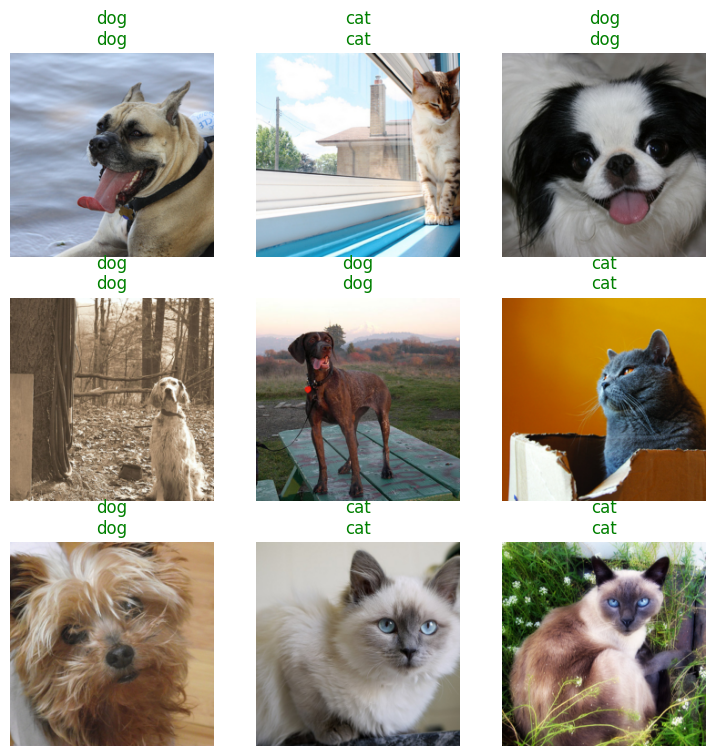

In [ ]:
lrnr.show_results()

# 6. 오답분석

interpretation.from_learner 함수는 학습된 모델을 해석하는데 사용되는 함수이다. inter 는 interpretation 객체이다. 취약점을 분석하는 오브젝트라고 이해해도 괜찮다.

In [ ]:
inter = Interpretation.from_learner(lrnr) #무엇을 틀리는지 알려주는 역할.

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


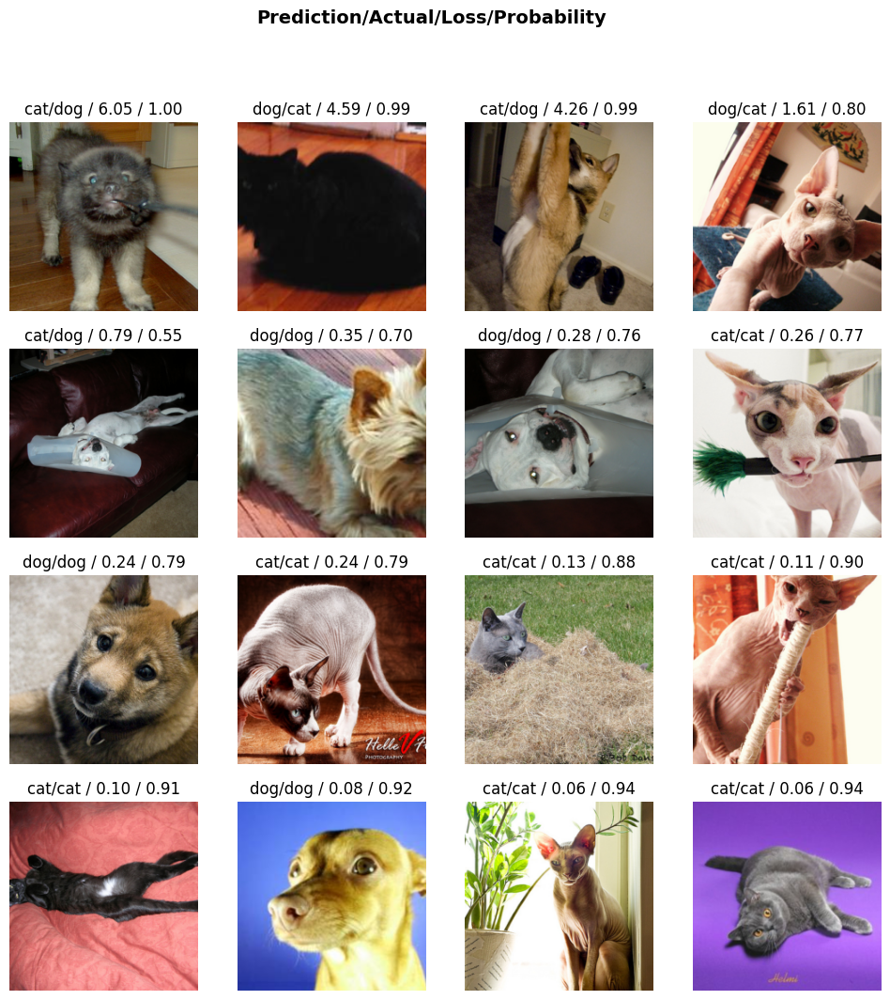

In [ ]:
inter.plot_top_losses(16) # 오답을 분석하는 오브젝트는 가장 오류가 높은 이미지를 정렬하여 보여주는 기능이 있음..

# 7. 진짜 잘되는게 맞는건가?

In [ ]:
import requests

## A. 최하니

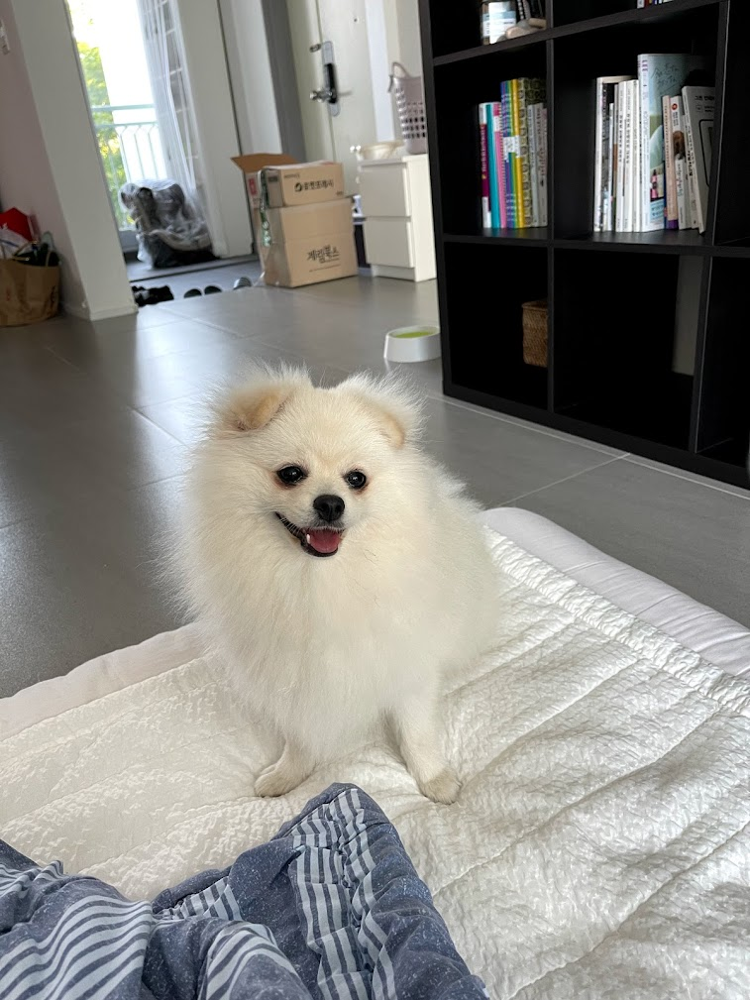

In [ ]:
hani1 = PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani1.jpeg?raw=true').content)
hani1

In [ ]:
lrnr.predict(hani1)

('dog', tensor(1), tensor([3.2796e-08, 1.0000e+00]))

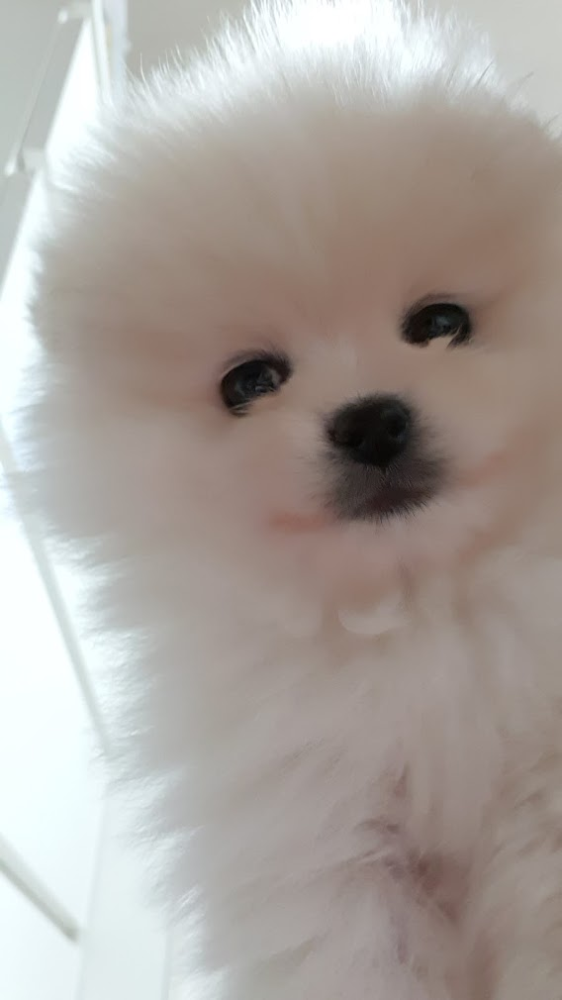

In [ ]:
hani2 = PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani2.jpeg?raw=true').content)
hani2

In [ ]:
lrnr.predict(hani2)

('dog', tensor(1), tensor([2.2489e-07, 1.0000e+00]))

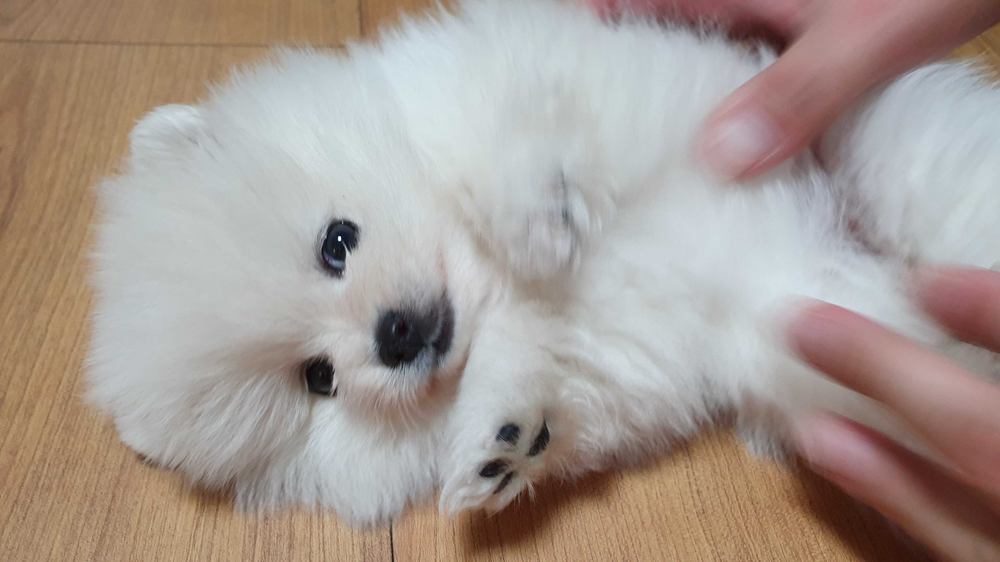

In [ ]:
hani3 = PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-hani3.jpg?raw=true').content)
hani3

In [ ]:
lrnr.predict(hani3)

('dog', tensor(1), tensor([4.1440e-04, 9.9959e-01]))

## B. 인터넷 고양이

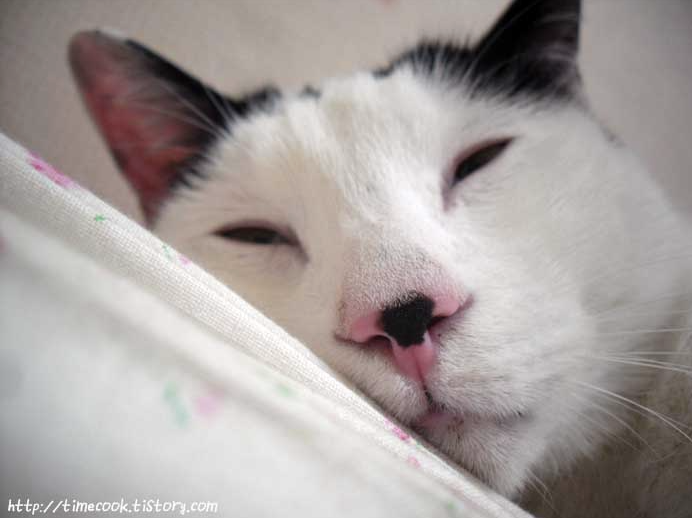

In [ ]:
cat1 = PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-cat1.png?raw=true').content)
cat1

In [ ]:
lrnr.predict(cat1) #잘맞춘다.

('cat', tensor(0), tensor([1.0000e+00, 1.4082e-09]))

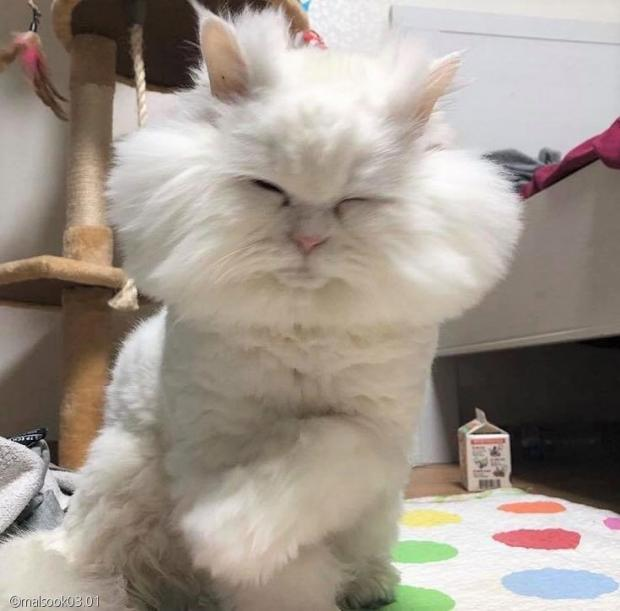

In [ ]:
cat2 = PILImage.create(requests.get('https://github.com/guebin/DL2024/blob/main/imgs/01wk-cat2.jpeg?raw=true').content)
cat2

In [ ]:
lrnr.predict(cat2)

('cat', tensor(0), tensor([9.9988e-01, 1.1997e-04]))

# 8. 크롤링

- 지금까지는 cat/dog를 분류할 수 있는 인공 지능을 만든것... 이번엔 iu와 hynn을 구분하는 인공지능을 만들고 싶다..

idea.. 뭐든 학습 시키기 나름!!

In [ ]:
# 크롤링에 필요한 준비작업들
!pip install -U duckduckgo_search
from duckduckgo_search import DDGS #이미지파일을 크롤링할 수 있는 패키지

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 20.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.1/141.1 kB 17.1 MB/s eta 0:00:00


In [ ]:
def search_images(keyword, max_images=200):
    with DDGS() as ddgs:
        ddgs_images_gen = ddgs.images(
          keyword,
          max_results=max_images,
        ) #키워드에 대한 이미지 검색, max_images 수 만큼 크롤링
        results = [r for r in ddgs_images_gen] #이미지 결과 리스트 저장
    image_sources = [r['image'] for r in results] #이미지의 소스 url을 추출하여 리스트 저장
    return image_sources #이미지 소스 url 반환

In [ ]:
# 폴더만드는코드 -- 사실 손으로 만들어도 무방함..
!mkdir images
!mkdir images/train
!mkdir images/train/iu
!mkdir images/train/hynn
# !rm -rf images # 만들어진 폴더를 지우는 코드

#### 이미지 다운로드

In [ ]:
download_images(dest='./images/train/hynn',urls=search_images('HYNN',max_images=200))
download_images(dest='./images/train/iu',urls=search_images('IU',max_images=200))

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


#### 불량 이미지 목록 확보

In [ ]:
bad_images = verify_images(get_image_files('./images')) #불량 이미지를 추려줌
bad_images

(#9) [Path('images/train/hynn/b129b176-c200-425b-8ff0-4c19db597b76.png'),Path('images/train/hynn/e104cb2f-fe27-4d93-90a3-967010623030.png'),Path('images/train/hynn/f74d3849-376e-416c-99e6-683154a81aad.jpg'),Path('images/train/hynn/f21c3eb7-a411-45da-9f89-863adb13a3cf.jpg'),Path('images/train/hynn/146e4b25-e0f8-40b0-8c7d-cea68bac14e6.jpg'),Path('images/train/hynn/4b8821a6-ea67-4c82-a467-dab4bba38f69.jpg'),Path('images/train/hynn/2402999a-84a4-477b-a504-66238823941d.png'),Path('images/train/hynn/58d46cf9-1121-481a-a987-8b4e509c699e.jpg'),Path('images/train/iu/1b7a2876-664f-4c7f-bfeb-f12ff207059d.jpg')]

#### 불량 이미지는 학습에서 제거..

In [ ]:
bad_images.map(Path.unlink) #불량 이미지 학습에서 제거...

(#9) [None,None,None,None,None,None,None,None,None]

# 9. dls $\to$ lrnr $\to$ fit $\to$ predict

## A. Step1: DLS(=데이터) 준비

In [ ]:
dls = ImageDataLoaders.from_folder(
    path = './images', #이미지 저장 경로
    train='train', #훈련 데이터 'train' 지정
    valid_pct = 0.2, #제대로 학습을 하기 위해 약 20%정도를 빼봄.
    item_tfms=Resize(224), #이미지 사이즈 획일
)

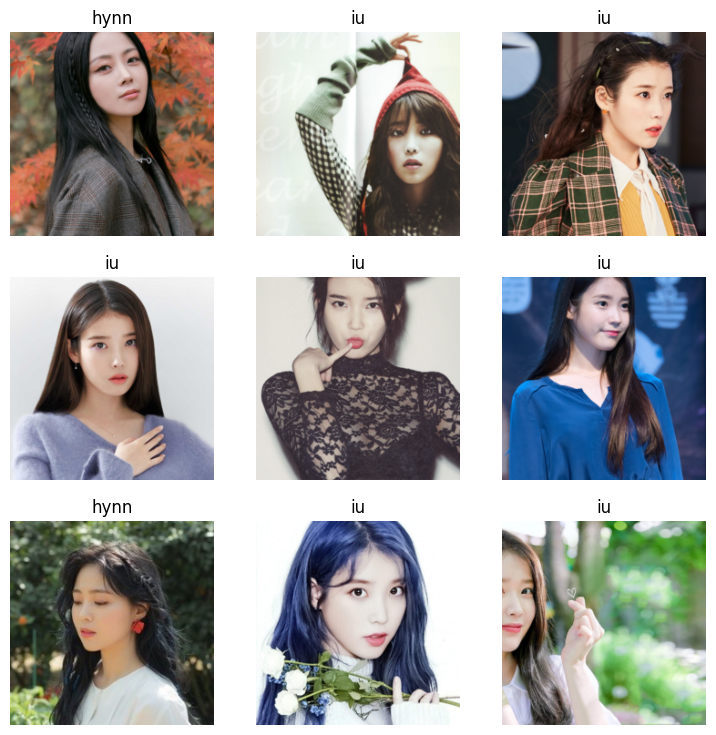

In [ ]:
dls.show_batch() #DLS에 자료들이 잘 정리되어 있는지 확인.

## B. Step2: 러너생성

In [ ]:
lrnr = vision_learner(
    dls = dls,
    arch = resnet34,
    metrics = accuracy
) #학습

## C. Step3: 학습

In [ ]:
lrnr.fine_tune(7) #사전 학습된 모델을 새로운 데이터 셋에 적응시키는 방법.
#7번의 에폭(학습단계) 동안 미세 조정

epoch,train_loss,valid_loss,accuracy,time
0,0.050569,0.338891,0.863014,00:10


epoch,train_loss,valid_loss,accuracy,time
0,0.074512,0.427947,0.849315,00:10
1,0.043563,0.605900,0.821918,00:09
2,0.040972,0.795281,0.808219,00:10
3,0.037020,0.923605,0.835616,00:10
4,0.034799,0.837274,0.821918,00:10
5,0.035514,0.676051,0.821918,00:10
6,0.030113,0.514633,0.835616,00:10


## D. Step4: 예측

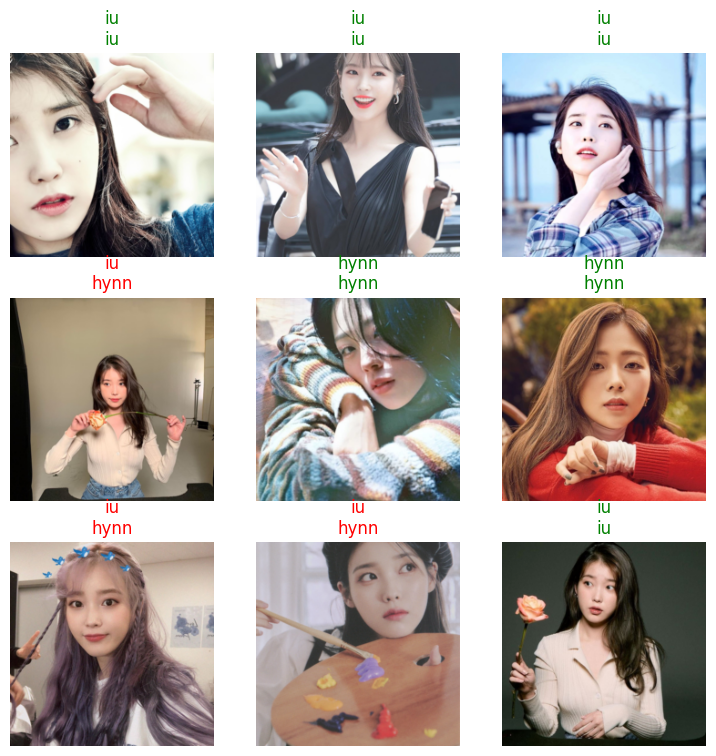

In [ ]:
lrnr.show_results() #데이터셋의 레이블과 결과 배열

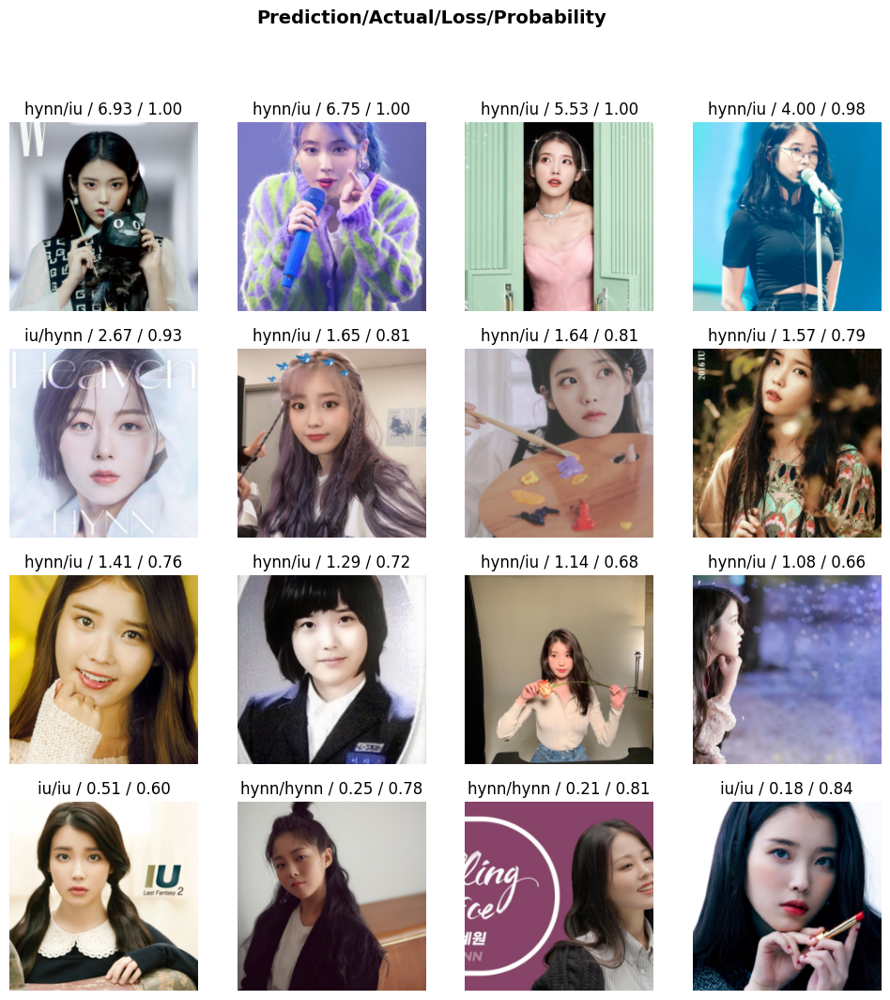

In [ ]:
inter = Interpretation.from_learner(lrnr)
inter.plot_top_losses(16)

# 10. 숙제

In [ ]:
#새 데이터 저장 파일 생성
!mkdir images/train1
!mkdir images/train1/shinhyunjoon
!mkdir images/train1/zlatan

mkdir: cannot create directory ‘images/train1’: File exists
mkdir: cannot create directory ‘images/train1/shinhyunjoon’: File exists
mkdir: cannot create directory ‘images/train1/zlatan’: File exists


In [ ]:
#이미지 크롤링
download_images(dest='./images/train1/shinhyunjoon',urls=search_images('shinhyunjoon',max_images=200))
download_images(dest='./images/train1/zlatan',urls=search_images('zlatan',max_images=200))

In [ ]:
#불량 이미지 목록 확보, 삭제
bad_images = verify_images(get_image_files('./images/train1'))
bad_images.map(Path.unlink)

(#17) [None,None,None,None,None,None,None,None,None,None...]

In [ ]:
# 데이터 로더 객체 생성
dls = ImageDataLoaders.from_folder(
    path = './images/train1',
    train='train1',
    valid_pct = 0.2,
    item_tfms=Resize(224),
)

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


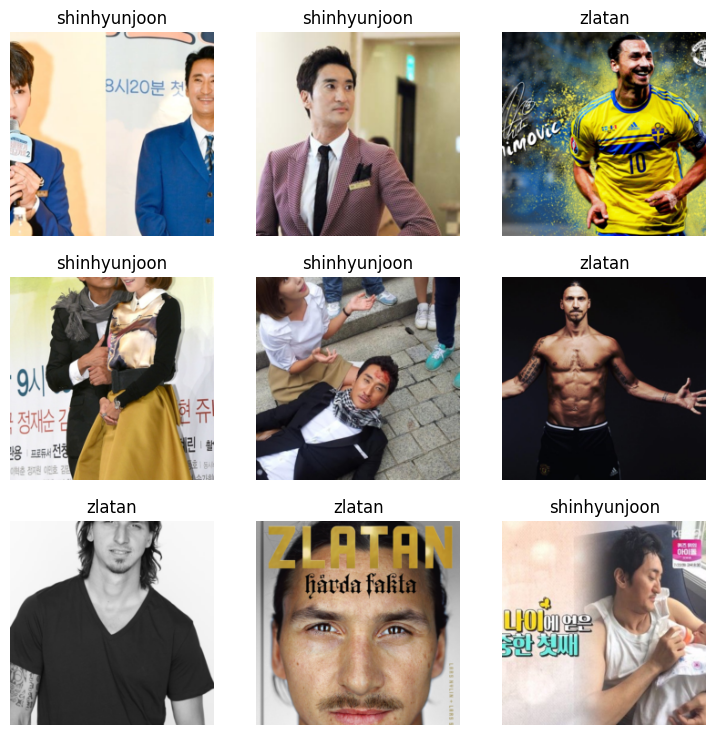

In [ ]:
dls.show_batch()

In [ ]:
#학습
lrnr = vision_learner(
    dls = dls,
    arch = resnet34,
    metrics = accuracy
)

lrnr.fine_tune(3)

epoch,train_loss,valid_loss,accuracy,time
0,1.102780,0.577923,0.835616,00:12


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,accuracy,time
0,0.218945,0.181480,0.958904,00:12
1,0.150599,0.142718,0.986301,00:12
2,0.111246,0.111132,0.986301,00:12


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:996: UserWarning: Palette images with Transparency expressed in bytes sh

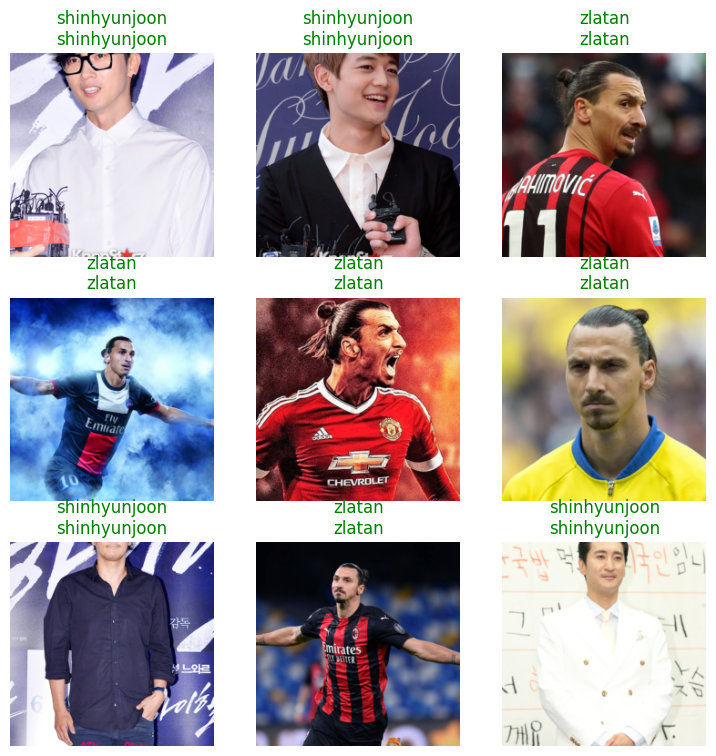

In [ ]:
lrnr.show_results()

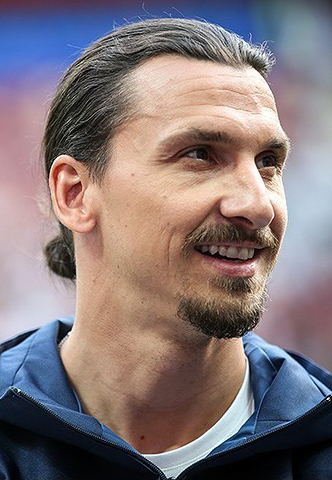

In [ ]:
#새 이미지
zlatan1 = PILImage.create(requests.get('https://upload.wikimedia.org/wikipedia/commons/0/09/Zlatan_Ibrahimovi%C4%87_June_2018.jpg').content)
zlatan1

In [ ]:
lrnr.predict(zlatan1) #즐라탄으로 예측 하였다.

('zlatan', tensor(1), tensor([0.0036, 0.9964]))

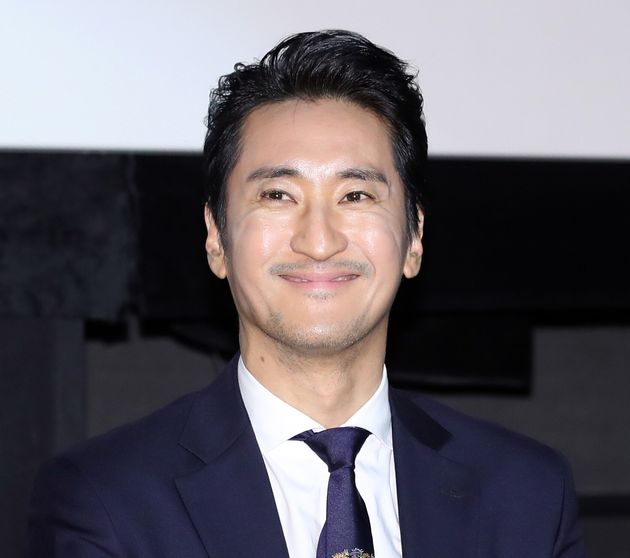

In [ ]:
shinhyunjoon1 = PILImage.create(requests.get('https://cdn.huffingtonpost.kr/news/photo/202005/97486_181662.jpeg').content)
shinhyunjoon1

In [ ]:
lrnr.predict(shinhyunjoon1)

('shinhyunjoon', tensor(0), tensor([9.9998e-01, 2.3622e-05]))

In [ ]:
#아쉬운 점... 신현준이라는 키워드로 크롤링했는데 다른 사람들이 있는 것이 아쉽다..